## Tidal Debris from M33

In [1]:
import numpy as np
import astropy.units as u
from astropy.constants import G

# import plotting modules
import matplotlib.pyplot as plt
import matplotlib
%matplotlib inline

# my modules
from ReadFile import Read

# edit CenterOfMass2 to Calculate COM of all components 
from CenterOfMass2 import CenterOfMass
# edit GalaxyMAss to Calculate Mass of all components 
from GalaxyMass import ComponentMass


In [2]:
def Mass_enclose(filename,radius,COMP):
# function to compute the mass of all particles less than the distance between two Galaxy COM position 
# Inputs:
#       filename: galaxyfile for input
#       radius: COM position difference in kpc
#       COMP: COM positon of each galaxy [x, y, z]
#       output: Mass in units of Msun. 
    
    # read in the file 
    time, total, data = Read(filename)
    
    # gather particles with the same type and sum up the mass
    mass = np.round(data[np.sqrt((data['x']-COMP[0])**2+(data['y']-COMP[1])**2+(data['z']-COMP[2])**2) < radius]['m'].sum() * 1e10, 3)
    
    # return the mass 
    return mass


In [3]:
def Select_tides_star(M33,Rj_MW_M33,Rj_M31_M33,COMP_M33):
    """Select tides star of M33"""
    # Inputs:
    #      M33: each snap file name of M33
    #      Rj_MW_M33: Jacobi Radius of MW and M33 system
    #      Rj_M1_M33: Jacobi Radius of M31 and M33 system
    #      COMP_M33: COM positon of M33 [x, y, z]
    # Outpur:
    #      tidal_star list 
    time, total, data = Read(M33)
    MW_index = np.where(np.sqrt((data['x']-COMP_M33[0])**2+(data['y']-COMP_M33[1])**2+(data['z']-COMP_M33[2])**2) >= Rj_MW_M33)
    M31_index = np.where(np.sqrt((data['x']-COMP_M33[0])**2+(data['y']-COMP_M33[1])**2+(data['z']-COMP_M33[2])**2) >= Rj_M31_M33)
#    total_index = M31_index
#    for i in range(len(MW_index)):
#        if MW_index[i] not in total_index:
#            total_index = np.append(total_index,MW_index[i])
    
    tidal_star_MW = data[MW_index]
    tidal_star_M31 = data[M31_index]
#    tidal_star_total = data[total_index]
    
    return tidal_star_MW, tidal_star_M31

In [4]:
def Tides_star_mass(tidal_star_MW,tidal_star_M31):
    """Select tides star mass of M33"""
    # Inputs:
    #      tidal_star list of MW, M31 and total    
    # Output:
    #      tidal_star mass unit is Msun

    Mass_tidal_MW = tidal_star_MW['m'].sum()*1e10
    Mass_tidal_M31 = tidal_star_M31['m'].sum()*1e10
#    Mass_tidal_total = tidal_star_total['m'].sum()*1e10
    
    return Mass_tidal_MW, Mass_tidal_M31

In [25]:
class Snap:
    """This is a class for each Snap with M31, MW, M33"""
    
    def __init__(self,Snap_number):
        # get the snap file name of MW M31 and M33
        # Inputs: Snapnumber
        # self.time unit is Myr
        
        self.Snap_number = Snap_number
        self.MWfilename = "VLowRes/" + 'MW' + "_VLowRes/" + 'MW' +  "_{:03d}".format(self.Snap_number) + ".txt"
        self.M31filename = "VLowRes/" + 'M31' + "_VLowRes/" + 'M31' +  "_{:03d}".format(self.Snap_number) + ".txt"
        self.M33filename = "VLowRes/" + 'M33' + "_VLowRes/" + 'M33' +  "_{:03d}".format(self.Snap_number) + ".txt"
        self.time = Snap_number*10/0.7
    
    def COM(self):
        # Calculate the COM Position of MW, M31 and M33 
        
        MW_COM = CenterOfMass(self.MWfilename)
        M31_COM = CenterOfMass(self.M31filename)
        M33_COM = CenterOfMass(self.M33filename)
        
        # For MW and M31 delta = 0.1 and VelDec = 2
        # For M33 dalta = 0.1 and VelDec = 2
        
        COMP_MW = MW_COM.COM_P(0.1,2)
        COMP_M31 = M31_COM.COM_P(0.1,2)
        COMP_M33 = M33_COM.COM_P(0.1,2)
        COMP_MW = COMP_MW.value
        COMP_M31 = COMP_M31.value
        COMP_M33 = COMP_M33.value
        
        return COMP_MW, COMP_M31, COMP_M33
    
    
    def COMdiff(self,galaxy1,galaxy2):
        # Calculate the COM Position distance of two Galaxy
        
        COMdiff = np.sqrt((galaxy1[0]-galaxy2[0])**2+(galaxy1[1]-galaxy2[1])**2+(galaxy1[2]-galaxy2[2])**2)        
        
        return COMdiff
    
    def Total_Mass(self,galaxy_name):
        # Calculate total Mass of each Galaxy 
        
        return ComponentMass(galaxy_name) 
    
    def Mass_enclose(self,PreRjMW_M33,PreRjM31_M33):
        # Calculate the Mass enclose less than the distance between two Galaxy COM Position
        
        #Calculate COM Positoon
        COMP_MW, COMP_M31, COMP_M33 = self.COM()
        
        #Calculate MW_M33 M31_M33 COMP difference
        MW_M33diff = self.COMdiff(COMP_MW,COMP_M33)
        M31_M33diff = self.COMdiff(COMP_M31,COMP_M33)
        
        #Calculate the mass inclose
        MW_enclose = Mass_enclose(self.MWfilename, MW_M33diff,COMP_MW)
        M31_enclose = Mass_enclose(self.M31filename, M31_M33diff,COMP_M31)
        M33_enclose_MW = Mass_enclose(self.M33filename, PreRjMW_M33,COMP_M33)
        M33_enclose_M31 = Mass_enclose(self.M33filename, PreRjM31_M33,COMP_M33)
        
        return M31_enclose, MW_enclose, M33_enclose_MW, M33_enclose_M31
    
    def Rj(self,PreRjMW_M33=10000,PreRjM31_M33=10000):
        # Calculate the Jacobi Radius of M31-M33 and MW-M33 system
        # Rj = r*(Msat/Mhost(<r))**(1/3)
        # Msat is M33, Mhost is enclose mass of MW and M31
        MWmass = self.Total_Mass(self.MWfilename)
        M31mass = self.Total_Mass(self.M31filename)
        M33mass = self.Total_Mass(self.M33filename)
        
        COMP_MW, COMP_M31, COMP_M33 = self.COM()
        
        MW_M33diff = self.COMdiff(COMP_MW,COMP_M33)
        M31_M33diff = self.COMdiff(COMP_M31,COMP_M33)
        
        M31_enclose, MW_enclose, M33_enclose_MW, M33_enclose_M31= self.Mass_enclose(PreRjMW_M33,PreRjM31_M33)
        
        Rj_MW_M33 = MW_M33diff *(M33_enclose_MW/MW_enclose)**(1/3)
        Rj_M31_M33 = M31_M33diff *(M33_enclose_M31/M31_enclose)**(1/3)
        
        return Rj_MW_M33, Rj_M31_M33
    
    def select_star(self,PreRjMW_M33=10000,PreRjM31_M33=10000):
        COMP_MW, COMP_M31, COMP_M33 = self.COM()
        Rj_MW_M33, Rj_M31_M33 = self.Rj(PreRjMW_M33,PreRjM31_M33)
        tidal_star_MW, tidal_star_M31 = Select_tides_star(self.M33filename,Rj_MW_M33,Rj_M31_M33,COMP_M33)
        
        return tidal_star_MW, tidal_star_M31

    def tidals_mass(self,PreRjMW_M33=10000,PreRjM31_M33=10000):
        tidal_star_MW, tidal_star_M31 = self.select_star(PreRjMW_M33,PreRjM31_M33)
        Mass_tidal_MW, Mass_tidal_M31 = Tides_star_mass(tidal_star_MW, tidal_star_M31)
        
        return Mass_tidal_MW, Mass_tidal_M31
        

In [6]:
# Test case and load Snap 0
t0 = Snap(0)

In [7]:
# Record the mass and define M33mass
t0.Mass_enclose(10000,10000)

(1280264413640.0, 1801289820000.0, 195913000000.0, 195913000000.0)

In [41]:
M33mass = 195913000000.0

In [68]:
# Use for loop record 
# Rj between MW_M33 system and M31_M33 system
# Tides mass of MW_M33 system and M31_M33 system
# Center of Mass Position of MW, M31 M33
# Center of Mass Position distance of MW_M33, MW_M31, M31_M33
# Select Tides star of MW_M33 system and M31_M33 system
# For loop from 0 to 801 interval is 5 Snap 
from tqdm import tqdm
snap_id = []

Rj_MW_M33 = []
Rj_M31_M33 = []

TideMassMW = []
TideMassM31 = []

COMPMW = []
COMPM31 = []
COMPM33 = []

disCOMPMW_M33 = []
disCOMPM31_M33 = []
disCOMPMW_M31 = []

Tidesstar_MW_M33 = []
Tidesstar_M31_M33 = []

#TideMassTotal = []
j = 0
for i in tqdm(range(0,801,5)):
    temp_snap = Snap(i)
    if i == 0:
        temp_Rj_MW_M33, temp_Rj_M31_M33 = temp_snap.Rj()
        temp_MMW,temp_M31 = temp_snap.tidals_mass()
        temp_COMPMW,temp_COMPM31,temp_COMPM33 = temp_snap.COM()
        
        temp_tidestar_MW_M33, temp_tidestar_M31_M33 = temp_snap.select_star()
        
        temp_disCOMPMW_M33 = temp_snap.COMdiff(temp_COMPMW,temp_COMPM33)
        temp_disCOMPM31_M33 = temp_snap.COMdiff(temp_COMPM31,temp_COMPM33)
        temp_disCOMPMW_M31 = temp_snap.COMdiff(temp_COMPMW,temp_COMPM31)
        
        Rj_MW_M33.append(temp_Rj_MW_M33)
        Rj_M31_M33.append(temp_Rj_M31_M33)
        
        TideMassMW.append(temp_MMW)
        TideMassM31.append(temp_M31)
        
        COMPMW.append(temp_COMPMW)
        COMPM31.append(temp_COMPM31)
        COMPM33.append(temp_COMPM33)
        
        Tidesstar_MW_M33.append(temp_tidestar_MW_M33)
        Tidesstar_M31_M33.append(temp_tidestar_M31_M33)
        
        disCOMPMW_M33.append(temp_disCOMPMW_M33)
        disCOMPM31_M33.append(temp_disCOMPM31_M33)
        disCOMPMW_M31.append(temp_disCOMPMW_M31)
       # TideMassTotal.append(temp_MT)
    else:
        temp_Rj_MW_M33, temp_Rj_M31_M33 = temp_snap.Rj(Rj_MW_M33[j],Rj_M31_M33[j])
        temp_MMW,temp_M31 = temp_snap.tidals_mass(Rj_MW_M33[j],Rj_M31_M33[j])
        
        temp_COMPMW,temp_COMPM31,temp_COMPM33 = temp_snap.COM()
        
        temp_tidestar_MW_M33, temp_tidestar_M31_M33 = temp_snap.select_star(Rj_MW_M33[j],Rj_M31_M33[j])


        temp_disCOMPMW_M33 = temp_snap.COMdiff(temp_COMPMW,temp_COMPM33)
        temp_disCOMPM31_M33 = temp_snap.COMdiff(temp_COMPM31,temp_COMPM33)
        temp_disCOMPMW_M31 = temp_snap.COMdiff(temp_COMPMW,temp_COMPM31)


        Rj_MW_M33.append(temp_Rj_MW_M33)
        Rj_M31_M33.append(temp_Rj_M31_M33)
        
        TideMassMW.append(temp_MMW)
        TideMassM31.append(temp_M31)
        
        COMPMW.append(temp_COMPMW)
        COMPM31.append(temp_COMPM31)
        COMPM33.append(temp_COMPM33)
        
        Tidesstar_MW_M33.append(temp_tidestar_MW_M33)
        Tidesstar_M31_M33.append(temp_tidestar_M31_M33)


        disCOMPMW_M33.append(temp_disCOMPMW_M33)
        disCOMPM31_M33.append(temp_disCOMPM31_M33)
        disCOMPMW_M31.append(temp_disCOMPMW_M31)

       # TideMassTotal.append(temp_MT)
        j += 1
    snap_id.append(i)


100%|██████████| 161/161 [1:30:33<00:00, 33.75s/it]


In [86]:
# Transfer Snap to Time (Gyr)
Time = []
for i in range(len(snap_id)):
     Time.append(snap_id[i]*(10/0.7)/1000)

In [87]:
Time

[0.0,
 0.07142857142857142,
 0.14285714285714285,
 0.2142857142857143,
 0.2857142857142857,
 0.35714285714285715,
 0.4285714285714286,
 0.5,
 0.5714285714285714,
 0.6428571428571429,
 0.7142857142857143,
 0.7857142857142858,
 0.8571428571428572,
 0.9285714285714287,
 1.0,
 1.0714285714285716,
 1.1428571428571428,
 1.2142857142857144,
 1.2857142857142858,
 1.3571428571428572,
 1.4285714285714286,
 1.5,
 1.5714285714285716,
 1.6428571428571428,
 1.7142857142857144,
 1.7857142857142858,
 1.8571428571428574,
 1.9285714285714286,
 2.0,
 2.0714285714285716,
 2.1428571428571432,
 2.2142857142857144,
 2.2857142857142856,
 2.357142857142857,
 2.428571428571429,
 2.5,
 2.5714285714285716,
 2.6428571428571432,
 2.7142857142857144,
 2.7857142857142856,
 2.857142857142857,
 2.928571428571429,
 3.0,
 3.0714285714285716,
 3.1428571428571432,
 3.214285714285715,
 3.2857142857142856,
 3.357142857142857,
 3.428571428571429,
 3.5,
 3.5714285714285716,
 3.6428571428571432,
 3.714285714285715,
 3.785714285

In [72]:
# Calculate Tides mass fraction of M33
Tides_MW_frac = np.array(TideMassMW)/M33mass
Tides_M31_frac = np.array(TideMassM31)/M33mass
#Tides_Tot_frac = np.array(TideMassTotal)/M33mass

In [43]:
Tides_M31_frac

array([0.32538423, 0.4006341 , 0.48007509, 0.57208949, 0.53856043,
       0.96704246, 0.57170848, 0.56523127, 0.5755186 , 0.61247676,
       0.63667102, 0.65857921, 0.6709672 , 0.6934418 , 0.72944744,
       0.74891478, 0.78346107, 0.78004728, 0.76687174, 0.76497688,
       0.80594259, 0.87434132, 0.87836417, 0.89039338, 0.89846461,
       0.89660565, 0.89511075, 0.90885814, 0.9127277 , 1.        ,
       0.92423841, 0.92237599, 0.92563863, 0.9264433 , 0.93412002,
       0.93659857, 0.93773173, 0.94605817, 0.94440306, 0.94746499,
       0.94402419])

In [44]:
Tides_MW_frac

array([0.11354157, 0.11258904, 0.1175422 , 0.11506562, 0.12516244,
       0.11963776, 0.16402566, 0.22555909, 0.34614938, 0.46388209,
       0.56789836, 0.63990962, 0.67839693, 0.71439746, 0.70201457,
       0.66829501, 0.71618348, 0.7747029 , 0.84269493, 0.83518188,
       0.84295706, 0.86177467, 0.87739633, 0.88883871, 0.89731301,
       0.89547447, 0.89352035, 0.90527079, 0.91021028, 0.9999949 ,
       0.92154745, 0.92074475, 0.92463506, 0.91552634, 0.93176068,
       0.93570894, 0.93727926, 0.94525696, 0.94393017, 0.946441  ,
       0.94278417])

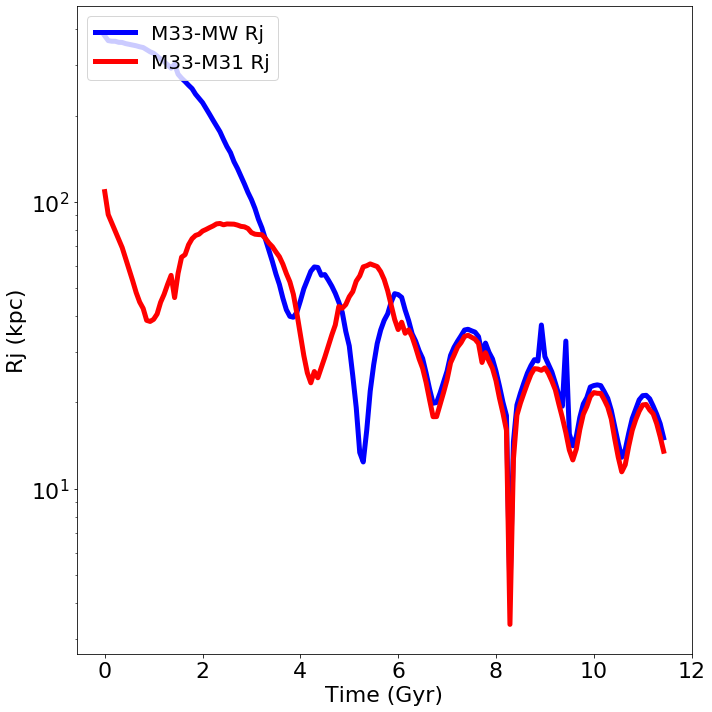

In [92]:
fig, ax= plt.subplots(figsize=(10, 10))

# Plot the Rj of M33 and MW
ax.semilogy(Time, Rj_MW_M33, 'b', lw=5, label='M33-MW Rj')

# Plot the Rj of M33 and M31
ax.semilogy(Time, Rj_M31_M33, 'r', lw=5, label='M33-M31 Rj')


# Add axis labels
ax.set_xlabel('Time (Gyr)', fontsize=22)
ax.set_ylabel('Rj (kpc)', fontsize=22)
#ax.set_title("Rj vs.Time", fontsize=22)

#adjust tick label font size
ax.xaxis.set_tick_params(labelsize=22)
ax.yaxis.set_tick_params(labelsize=22)

# add a legend with some customizations.
legend = ax.legend(loc='upper left',fontsize=20)

# tight layout
fig.tight_layout()

# Save to a file
fig.savefig('Rj_time.pdf')

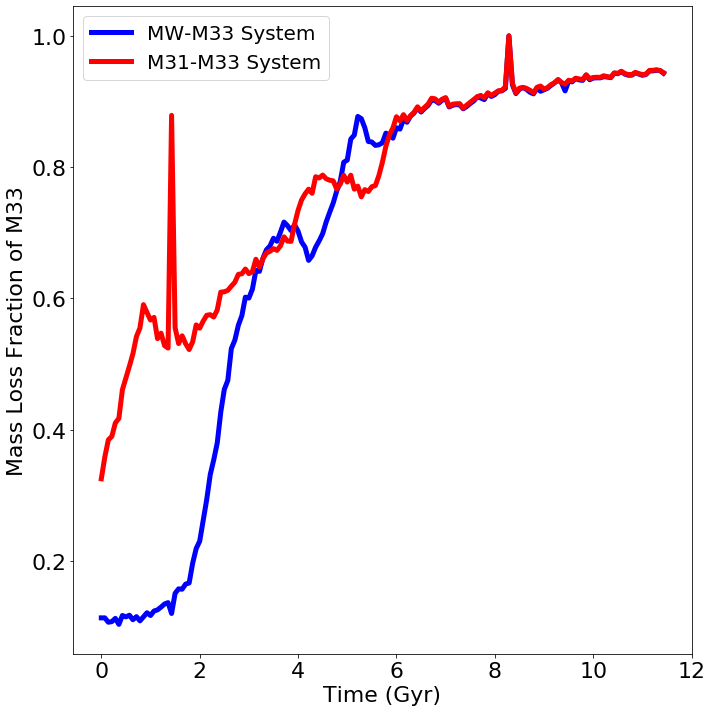

In [93]:
fig, ax= plt.subplots(figsize=(10, 10))

# Plot the Mass fraction of MW and M33 system
ax.plot(Time, Tides_MW_frac, 'b', lw=5, label='MW-M33 System')

# Plot the Mass fraction of M31 and M33 system
ax.plot(Time, Tides_M31_frac, 'r', lw=5, label='M31-M33 System')

# Plot the simulated separation of M31 and M33
#ax.plot(snap_id, Tides_Tot_frac, 'cyan', lw=5, label='Total Mass Loss')


# Add axis labels
ax.set_xlabel('Time (Gyr)', fontsize=22)
ax.set_ylabel('Mass Loss Fraction of M33', fontsize=22)
#ax.set_title("Mass Loss Fraction Vs. Snap Time", fontsize=22)

#adjust tick label font size
ax.xaxis.set_tick_params(labelsize=22)
ax.yaxis.set_tick_params(labelsize=22)

# add a legend with some customizations.
legend = ax.legend(loc='upper left',fontsize=20)

# tight layout
fig.tight_layout()

# Save to a file
fig.savefig('Mass_Loss_Frac.pdf')

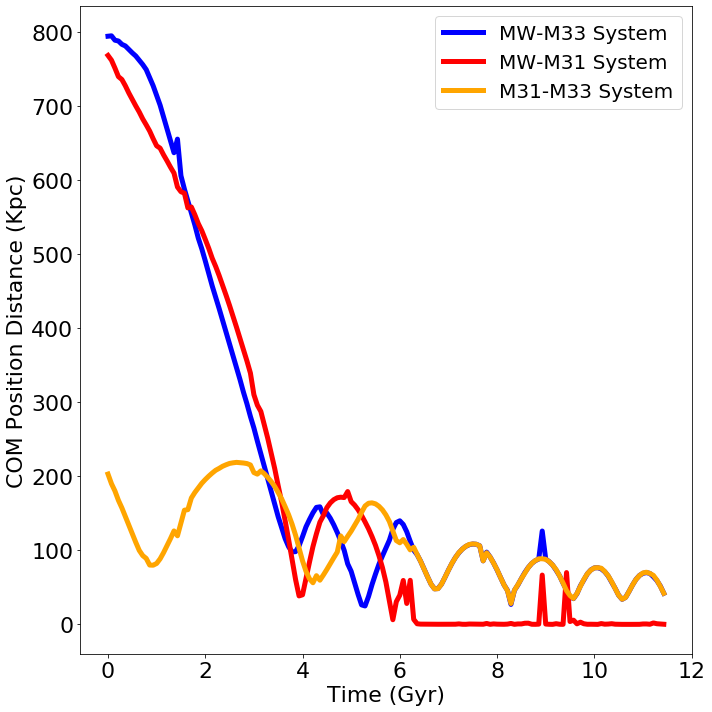

In [263]:
fig, ax= plt.subplots(figsize=(10, 10))

# Plot the COMP separation of MW and M33
ax.plot(Time, disCOMPMW_M33, 'b', lw=5, label='MW-M33 System')

ax.plot(Time, disCOMPMW_M31, 'r', lw=5, label='MW-M31 System')

# Plot the COMP separation of M31 and M33
ax.plot(Time, disCOMPM31_M33, 'orange', lw=5, label='M31-M33 System')

# Plot the simulated separation of M31 and M33
#ax.plot(snap_id, Tides_Tot_frac, 'cyan', lw=5, label='Total Mass Loss')


# Add axis labels
ax.set_xlabel('Time (Gyr)', fontsize=22)
ax.set_ylabel('COM Position Distance (Kpc)', fontsize=22)
#ax.set_title("Mass Loss Fraction Vs. Snap Time", fontsize=22)

#adjust tick label font size
ax.xaxis.set_tick_params(labelsize=22)
ax.yaxis.set_tick_params(labelsize=22)

# add a legend with some customizations.
legend = ax.legend(loc='upper right',fontsize=20)

# tight layout
fig.tight_layout()

# Save to a file
fig.savefig('ComP_dis.pdf')

In [99]:
# import 3D plot model
from mpl_toolkits.mplot3d import Axes3D

In [240]:
# Record each Galaxy COMP X, Y, Z value
COMPMW_X = []
COMPMW_Y = []
COMPMW_Z = []

COMPM31_X = []
COMPM31_Y = []
COMPM31_Z = []

COMPM33_X = []
COMPM33_Y = []
COMPM33_Z = []

In [241]:
for i in range(len(COMPMW)):
    COMPMW_X.append(COMPMW[i][0])
    COMPMW_Y.append(COMPMW[i][1])
    COMPMW_Z.append(COMPMW[i][2])
    
    COMPM31_X.append(COMPM31[i][0])
    COMPM31_Y.append(COMPM31[i][1])
    COMPM31_Z.append(COMPM31[i][2])
    
    COMPM33_X.append(COMPM33[i][0])
    COMPM33_Y.append(COMPM33[i][1])
    COMPM33_Z.append(COMPM33[i][2])

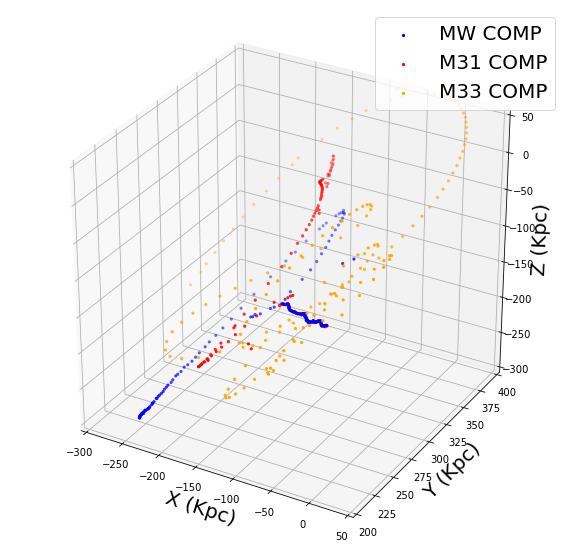

In [262]:
fig = plt.figure(figsize=(10, 10))
ax = fig.add_subplot(111, projection='3d')

# Plot the COMP of MW and M31 and M33
ax.scatter(COMPMW_X,COMPMW_Y,COMPMW_Z, s = 5 ,c = 'b', label='MW COMP')
ax.scatter(COMPM31_X,COMPM31_Y,COMPM31_Z, s = 5 ,c = 'r', label='M31 COMP')
ax.scatter(COMPM33_X,COMPM33_Y,COMPM33_Z, s = 5 ,c = 'orange', label='M33 COMP')

# Add axis labels
ax.set_xlabel('X (Kpc)', fontsize=20)
ax.set_ylabel('Y (Kpc)', fontsize=20)
ax.set_zlabel('Z (Kpc)', fontsize=20)

# Add axis limits
ax.set_xlim(-300,50)
ax.set_ylim(200,400)
ax.set_zlim(-300,50)

# add a legend with some customizations.
legend = ax.legend(loc='upper right',fontsize=20)

# Save to a file
fig.savefig('ComP_mov.pdf')

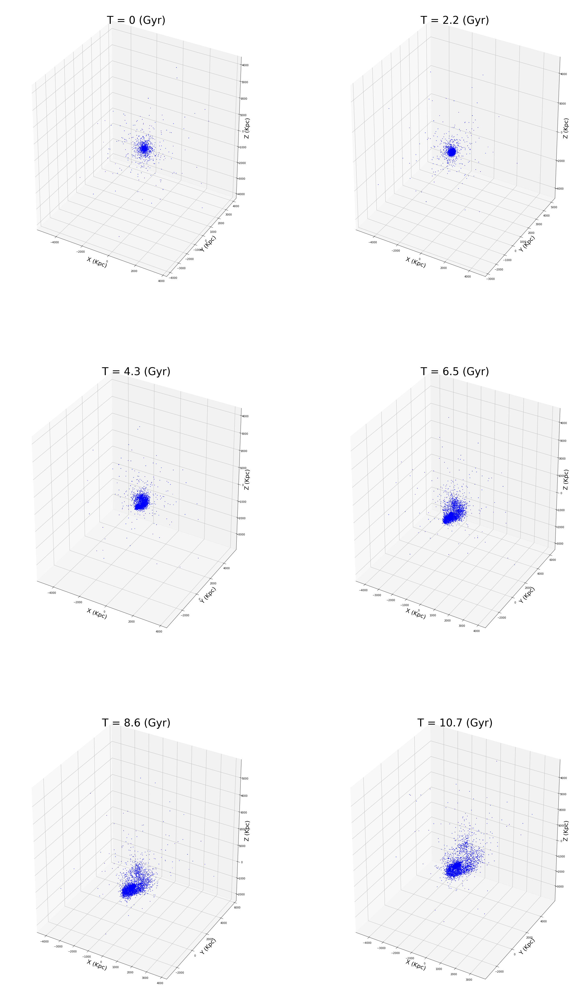

In [211]:
fig = plt.figure(figsize=(40, 70))

# Plot the M33 stream star at T = 0 Gyr
ax = fig.add_subplot(3, 2, 1, projection='3d')
ax.scatter(Tidesstar_M31_M33[0]['x'],Tidesstar_M31_M33[0]['y'],Tidesstar_M31_M33[0]['z'], s = 1 ,c = 'b')
ax.scatter(Tidesstar_MW_M33[0]['x'],Tidesstar_MW_M33[0]['y'],Tidesstar_MW_M33[0]['z'], s = 1 ,c = 'b')

ax.set_xlabel('X (Kpc)', fontsize=22)
ax.set_ylabel('Y (Kpc)', fontsize=22)
ax.set_zlabel('Z (Kpc)', fontsize=22)
ax.set_title(" T = 0 (Gyr)", fontsize=40)


# Plot the M33 stream star at T = 2.2 Gyr
ax = fig.add_subplot(3, 2, 2, projection='3d')
ax.scatter(Tidesstar_M31_M33[31]['x'],Tidesstar_M31_M33[31]['y'],Tidesstar_M31_M33[31]['z'], s = 1 ,c = 'b')
ax.scatter(Tidesstar_MW_M33[31]['x'],Tidesstar_MW_M33[31]['y'],Tidesstar_MW_M33[31]['z'], s = 1 ,c = 'b')

ax.set_xlabel('X (Kpc)', fontsize=22)
ax.set_ylabel('Y (Kpc)', fontsize=22)
ax.set_zlabel('Z (Kpc)', fontsize=22)
ax.set_title(" T = 2.2 (Gyr)", fontsize=40)


# Plot the M33 stream star at T = 4.3 Gyr
ax = fig.add_subplot(3, 2, 3, projection='3d')
ax.scatter(Tidesstar_M31_M33[61]['x'],Tidesstar_M31_M33[61]['y'],Tidesstar_M31_M33[61]['z'], s = 1 ,c = 'b')
ax.scatter(Tidesstar_MW_M33[61]['x'],Tidesstar_MW_M33[61]['y'],Tidesstar_MW_M33[61]['z'], s = 1 ,c = 'b')

ax.set_xlabel('X (Kpc)', fontsize=22)
ax.set_ylabel('Y (Kpc)', fontsize=22)
ax.set_zlabel('Z (Kpc)', fontsize=22)
ax.set_title(" T = 4.3 (Gyr)", fontsize=40)


# Plot the M33 stream star at T = 6.5 Gyr
ax = fig.add_subplot(3, 2, 4, projection='3d')
ax.scatter(Tidesstar_M31_M33[91]['x'],Tidesstar_M31_M33[91]['y'],Tidesstar_M31_M33[91]['z'], s = 1 ,c = 'b')
ax.scatter(Tidesstar_MW_M33[91]['x'],Tidesstar_MW_M33[91]['y'],Tidesstar_MW_M33[91]['z'], s = 1 ,c = 'b')

ax.set_xlabel('X (Kpc)', fontsize=22)
ax.set_ylabel('Y (Kpc)', fontsize=22)
ax.set_zlabel('Z (Kpc)', fontsize=22)
ax.set_title(" T = 6.5 (Gyr)", fontsize=40)


# Plot the M33 stream star at T = 8.6 Gyr
ax = fig.add_subplot(3, 2, 5, projection='3d')
ax.scatter(Tidesstar_M31_M33[121]['x'],Tidesstar_M31_M33[121]['y'],Tidesstar_M31_M33[121]['z'], s = 1 ,c = 'b')
ax.scatter(Tidesstar_MW_M33[121]['x'],Tidesstar_MW_M33[121]['y'],Tidesstar_MW_M33[121]['z'], s = 1 ,c = 'b')

ax.set_xlabel('X (Kpc)', fontsize=22)
ax.set_ylabel('Y (Kpc)', fontsize=22)
ax.set_zlabel('Z (Kpc)', fontsize=22)
ax.set_title(" T = 8.6 (Gyr)", fontsize=40)


# Plot the M33 stream star at T = Gyr
ax = fig.add_subplot(3, 2, 6, projection='3d')
ax.scatter(Tidesstar_M31_M33[151]['x'],Tidesstar_M31_M33[151]['y'],Tidesstar_M31_M33[151]['z'], s = 1 ,c = 'b')
ax.scatter(Tidesstar_MW_M33[151]['x'],Tidesstar_MW_M33[151]['y'],Tidesstar_MW_M33[151]['z'], s = 1 ,c = 'b')

ax.set_xlabel('X (Kpc)', fontsize=22)
ax.set_ylabel('Y (Kpc)', fontsize=22)
ax.set_zlabel('Z (Kpc)', fontsize=22)
ax.set_title(" T = 10.7 (Gyr)", fontsize=40)

fig.savefig('Evolution.pdf')